## Load images

In [16]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import PIL
import os

def imshow(img):
    img = img.astype(np.uint8)
    img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    display(PIL.Image.fromarray(img).convert("RGB"))
    
def imshow_on_axis(img, ax, title):
    img = img.astype(np.uint8)
    img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img)
    ax.set_title(title)
    ax.axis('off')

            
def load_images(number):
    final_images = []
    web_images = []
    ai_images = []

    final_path = f'data/final_submissions/{number}/'
    web_path = 'data/web/'
    ai_path = 'data/ai/'

  
    if not os.path.exists(final_path):
        print(f"The final submissions path '{final_path}' does not exist.")
        return None, None, None  


    for filename in os.listdir(final_path):
        img = cv2.imread(os.path.join(final_path, filename))
        if img is not None:
            final_images.append(img)

    if not final_images:
        print(f"No images found in '{final_path}'. Please check the contents.")
        return None, None, None

    for filename in os.listdir(web_path):
        if filename.startswith(str(number)):
            img = cv2.imread(os.path.join(web_path, filename))
            if img is not None:
                web_images.append(img)

    for filename in os.listdir(ai_path):
        if filename.startswith(str(number)):
            img = cv2.imread(os.path.join(ai_path, filename))
            if img is not None:
                ai_images.append(img)
    
    if not web_images and not ai_images:
        print(f"The number '{number}' does not correspond to any valid images in 'web' or 'ai' folders.")
        return None, None, None

    if not web_images:
        print(f"No web images found with prefix '{number}' in '{web_path}'.")
        return None, None, None
    if not ai_images:
        print(f"No AI images found with prefix '{number}' in '{ai_path}'.")
        return None, None, None

    return final_images, web_images, ai_images

## Color Hisotgrams Indexing

### Hue color histogram

In [17]:
def get_hue_histogram(image, num_buckets):
    image_hsv=cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hist = cv2.calcHist([image_hsv], [0], None, [num_buckets], [0, 180]) 

    hist = hist / np.sum(hist) 
    
    return hist


def hue_to_rgb(hue):
    hsv_color = np.uint8([[[hue, 255, 255]]])  
    rgb_color = cv2.cvtColor(hsv_color, cv2.COLOR_HSV2RGB)[0][0]
    return tuple(rgb_color / 255.0)  

def plot_hue_histogram(hist, axes, row, col, bucket_size, plt_title='Hue Histogram'): 
    axes[row, col].clear()  # Clear the axis for fresh plotting
    axes[row, col].set_title(plt_title)
    axes[row, col].set_xlabel('Bins')
    axes[row, col].set_ylabel('Frequency')

    bin_width = 180 / bucket_size
    for i in range(bucket_size):
        avg_hue = i * bin_width + bin_width / 2
        color = hue_to_rgb(avg_hue)
        axes[row, col].bar(i, hist[i][0], color=color, width=1)

    axes[row, col].set_xlim([0, bucket_size - 1])
    axes[row, col].grid(axis='y', linestyle='--')

### RGB color histogram

In [18]:
def get_rgb_histogram(image, num_buckets):
    hist = cv2.calcHist([image], [0, 1, 2], None, [num_buckets, num_buckets, num_buckets], [0, 256, 0, 256, 0, 256])
    
    # Normalize the histogram
    hist = hist / np.sum(hist)
    
    return hist

def plot_rgb_histogram(hist, axes, row, col, bucket_size, plt_title='RGB Histogram'):
    axes[row, col].clear()  # Clear the axis for fresh plotting
    axes[row, col].set_title(plt_title)
    axes[row, col].set_xlabel('Bins')
    axes[row, col].set_ylabel('Frequency')

    # Flatten the 3D histogram to separate RGB channels for plotting
    # Summing over one channel to reduce dimensionality
    hist_r = np.sum(hist, axis=(1, 2))  # Red channel
    hist_g = np.sum(hist, axis=(0, 2))  # Green channel
    hist_b = np.sum(hist, axis=(0, 1))  # Blue channel

    # Plot the histograms for each channel using the respective colors
    bin_indices = np.arange(bucket_size)
    axes[row, col].bar(bin_indices, hist_r, color='red', alpha=0.6, label='Red', width=1)
    axes[row, col].bar(bin_indices, hist_g, color='green', alpha=0.6, label='Green', width=1)
    axes[row, col].bar(bin_indices, hist_b, color='blue', alpha=0.6, label='Blue', width=1)

    # Set axis limits and enable grid for better visualization
    axes[row, col].set_xlim([0, bucket_size - 1])
    axes[row, col].grid(axis='y', linestyle='--')

    # Add legend to differentiate between RGB channels
    axes[row, col].legend()

## Histogram analysis

In [19]:
from typing import Literal

In [20]:
def compare_colors(group_id,
                   bucket_size,
                   color_convention: Literal['hue', 'rgb']
                   ):
    
    """
    Using color histograms of images on the specified color convention, compares simmilairty of color used in final project and its web and ai inspirations.

    Parameters:
    - group_id: ID for the image group.
    - bucket_size: Size of each bucket in the histogram.
    - color_convention: Specifies the color histogram type ('hue', 'rgb').

    Returns:
    - Boards with top 3 matches in AI and web inspirations.
    """
    
    get_histogram = globals().get(f"get_{color_convention}_histogram")
    plot_histogram = globals().get(f"plot_{color_convention}_histogram")
    
    final_images, web_images, ai_images = load_images(group_id)
    
    final_hists = [get_histogram(image, bucket_size) for image in final_images]
    web_hists = [get_histogram(image, bucket_size) for image in web_images]
    ai_hists = [get_histogram(image, bucket_size) for image in ai_images]
    
    for i in range(len(final_hists)):
        dist_web = [[cv2.compareHist(final_hists[i], web_hists[j], cv2.HISTCMP_BHATTACHARYYA), web_hists[j], web_images[j]]  for j in range(len(web_hists))] 
        dist_ai = [[cv2.compareHist(final_hists[i], ai_hists[j], cv2.HISTCMP_BHATTACHARYYA), ai_hists[j], ai_images[j]]  for j in range(len(ai_hists))]
    
        dist_web.sort(key=lambda x: x[0])
        dist_ai.sort(key=lambda x: x[0])
        
        fig, axes = plt.subplots(3, 6, figsize=(24, 12))
        final_image = final_images[i]
        
        imshow_on_axis(final_image, axes[0, 0], 'Final Image')
        
        plot_histogram(final_hists[i], axes, 0, 1, bucket_size=bucket_size, plt_title=f"{color_convention.upper()} Histogram of Final Image")
        
        for j in range(2, 6):
            axes[0, j].axis('off')
            
        top_web_matches=dist_web[:3]
        top_ai_matches=dist_ai[:3]
        
        for j in range(3):
            similarity, hist, img = top_web_matches[j]
            
            imshow_on_axis(img, axes[1, j*2], f'Web Match {j + 1}\nError: {similarity:.4f}')
            
            plot_histogram(hist, axes, 1, j*2 + 1, bucket_size=bucket_size, plt_title=f'{color_convention.upper()} Histogram of Web Match {j + 1}')
            
            
        for j in range(3):
            similarity, hist, img = top_ai_matches[j]
            
            imshow_on_axis(img, axes[2, j*2], f'AI Match {j + 1}\nError: {similarity:.4f}')
            
            plot_histogram(hist, axes, 2, j*2 + 1, bucket_size=bucket_size, plt_title=f'{color_convention.upper()} Histogram of AI Match {j + 1}')
            

        plt.tight_layout()
        plt.show()

In [21]:

def compare_results_diff_conventions(group_id,
                                     bucket_size,
                                     color_conv_1: Literal['hue', 'rgb'],
                                     color_conv_2: Literal['hue', 'rgb']
                                     ):
    """
    Compares results of two different color conventions for the same image group.

    Parameters:
    - group_id: ID for the image group.
    - bucket_size: Size of each bucket in the histogram.
    - color_conv_1: Specifies the color histogram type ('hue', 'rgb').
    - color_conv_2: Specifies the color histogram type ('hue', 'rgb').

    Returns:
    - Boards with top 3 matches in AI and web inspirations.
    """
    
    get_histogram_1 = globals().get(f"get_{color_conv_1}_histogram")
    get_histogram_2 = globals().get(f"get_{color_conv_2}_histogram")
    
    plot_histogram_1 = globals().get(f"plot_{color_conv_1}_histogram")
    plot_histogram_2 = globals().get(f"plot_{color_conv_2}_histogram")
    
    final_images, web_images, ai_images = load_images(group_id)
    
    final_hists_1 = [get_histogram_1(image, bucket_size) for image in final_images]
    web_hists_1 = [get_histogram_1(image, bucket_size) for image in web_images]
    ai_hists_1 = [get_histogram_1(image, bucket_size) for image in ai_images]
    
    final_hists_2 = [get_histogram_2(image, bucket_size) for image in final_images]
    web_hists_2 = [get_histogram_2(image, bucket_size) for image in web_images]
    ai_hists_2 = [get_histogram_2(image, bucket_size) for image in ai_images]

    
    for i in range(len(final_images)):
        #Consider different distance metrics
        dist_web_1 = [[cv2.compareHist(final_hists_1[i], web_hists_1[j], cv2.HISTCMP_BHATTACHARYYA), web_hists_1[j], web_images[j]]  for j in range(len(web_hists_1))] 
        dist_ai_1 = [[cv2.compareHist(final_hists_1[i], ai_hists_1[j], cv2.HISTCMP_BHATTACHARYYA), ai_hists_1[j], ai_images[j]]  for j in range(len(ai_hists_1))]
        
        dist_web_2 = [[cv2.compareHist(final_hists_2[i], web_hists_2[j], cv2.HISTCMP_BHATTACHARYYA), web_hists_2[j], web_images[j]] for j in range(len(web_hists_2))]
        dist_ai_2 = [[cv2.compareHist(final_hists_2[i], ai_hists_2[j], cv2.HISTCMP_BHATTACHARYYA), ai_hists_2[j], ai_images[j]]  for j in range(len(ai_hists_2))]
        
        min_idx_web_1 = min(range(len(dist_web_1)), key=lambda x: dist_web_1[x][0])
        min_idx_ai_1 = min(range(len(dist_ai_1)), key=lambda x: dist_ai_1[x][0])
        
        min_idx_web_2 = min(range(len(dist_web_2)), key=lambda x: dist_web_2[x][0])
        min_idx_ai_2 = min(range(len(dist_ai_2)), key=lambda x: dist_ai_2[x][0])
        
        
        fig, axes = plt.subplots(3, 5, figsize=(24, 12))
        final_image = final_images[i]
        
        imshow_on_axis(final_image, axes[0, 2], 'Final Image')
        
        plot_histogram_1(final_hists_1[i], axes, 0, 1, bucket_size=bucket_size, plt_title=f"{color_conv_1.upper()} Histogram of Final Image")
        plot_histogram_2(final_hists_2[i], axes, 0, 3, bucket_size=bucket_size, plt_title=f"{color_conv_2.upper()} Histogram of Final Image")
        
        
        axes[0, 0].axis('off')
        axes[0, 4].axis('off')
            
        imshow_on_axis(web_images[min_idx_web_1], axes[1, 0], f'Top Web Match {color_conv_1.upper()}\nError: {dist_web_1[min_idx_web_1][0]:.4f}')
        plot_rgb_histogram(dist_web_1[min_idx_web_1][1], axes, 1, 1, bucket_size=bucket_size, plt_title=f"{color_conv_1.upper()} Histogram of Top Web Match")
        axes[1, 2].axis('off')
        imshow_on_axis(web_images[min_idx_web_2], axes[1, 4], f'Top Web Match {color_conv_2.upper()}\nError: {dist_web_2[min_idx_web_2][0]:.4f}')
        plot_hue_histogram(dist_web_2[min_idx_web_2][1], axes, 1, 3, bucket_size=bucket_size, plt_title=f"{color_conv_2.upper()} Histogram of Top Web Match")
        
        imshow_on_axis(ai_images[min_idx_ai_1], axes[2, 0], f'Top AI Match {color_conv_1.upper()}\nError: {dist_ai_1[min_idx_ai_1][0]:.4f}')
        plot_rgb_histogram(dist_ai_1[min_idx_ai_1][1], axes, 2, 1, bucket_size=bucket_size, plt_title=f"{color_conv_1.upper()} Histogram of Top AI Match")
        axes[2, 2].axis('off')
        imshow_on_axis(ai_images[min_idx_ai_2], axes[2, 4], f'Top AI Match {color_conv_2.upper()}\nError: {dist_ai_2[min_idx_ai_2][0]:.4f}')
        plot_hue_histogram(dist_ai_2[min_idx_ai_2][1], axes, 2, 3, bucket_size=bucket_size, plt_title=f"{color_conv_2.upper()} Histogram of Top AI Match")
        
            
        plt.tight_layout()
        plt.show()

## Analysis of the result

### RGB vs HUE top 1 matches

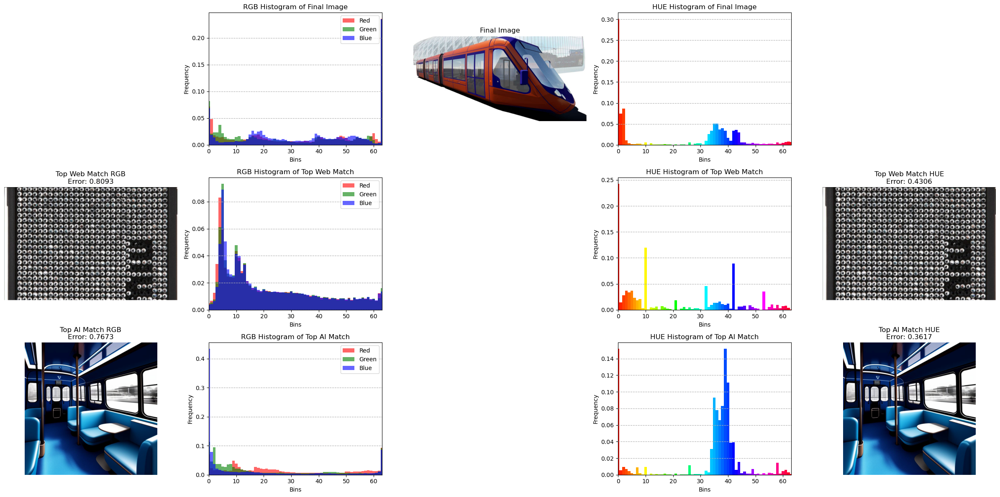

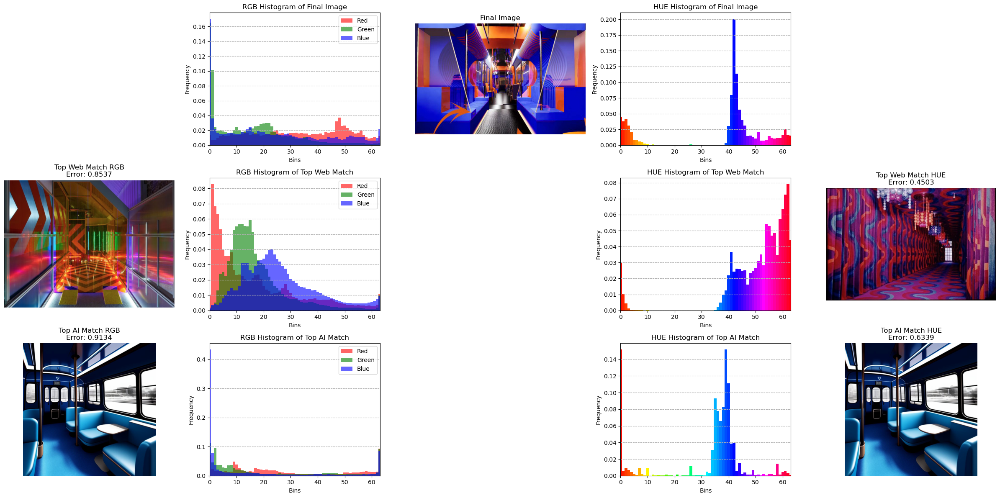

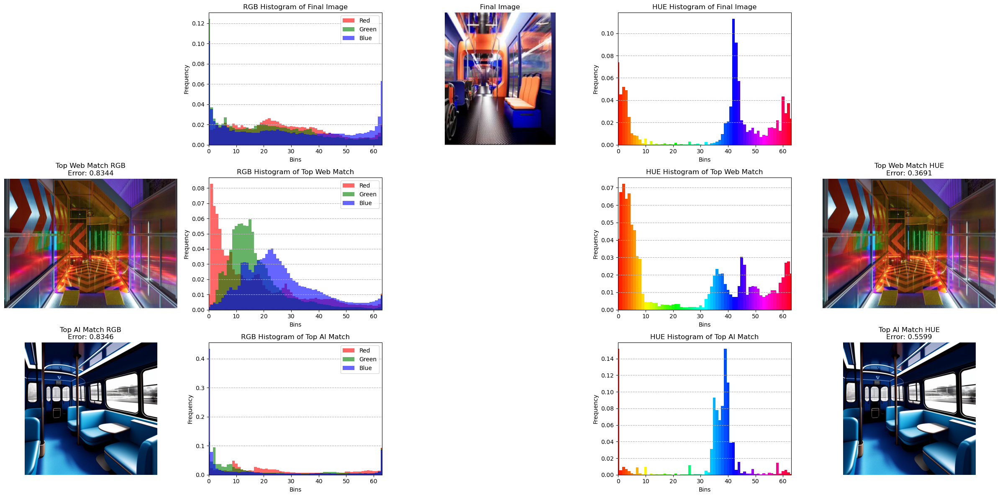

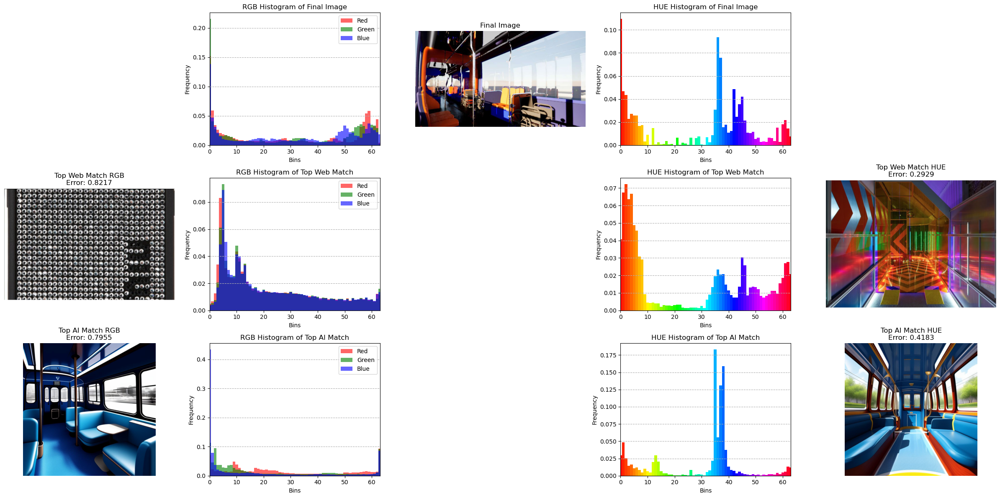

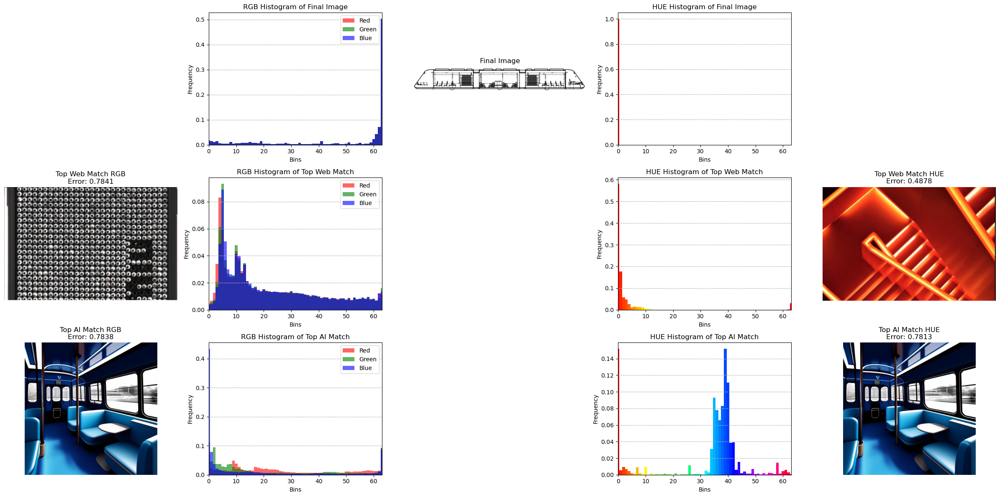

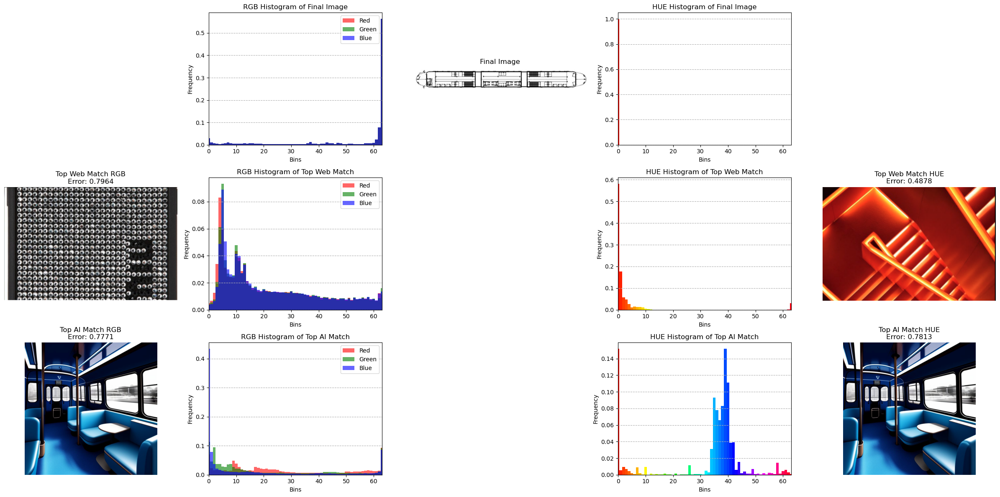

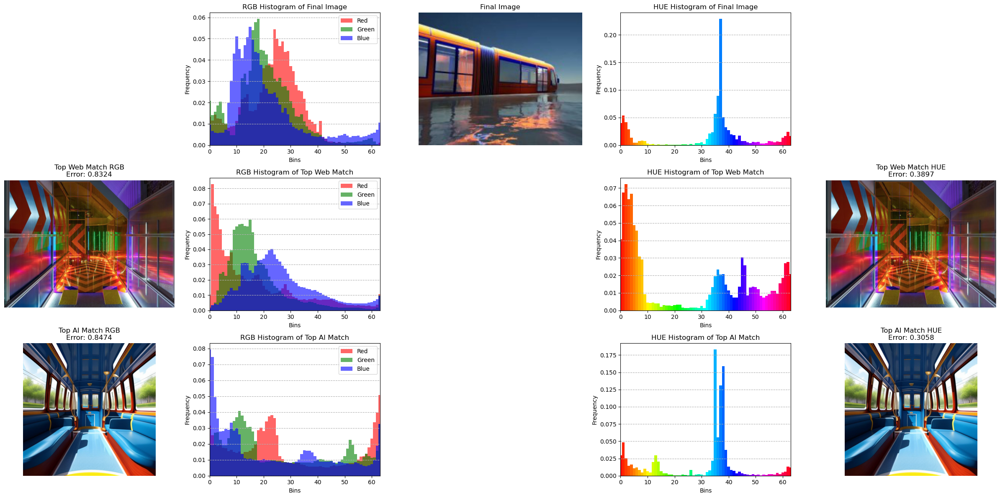

In [22]:
compare_results_diff_conventions(22, 64, 'rgb', 'hue')

### HUE top 3 matches

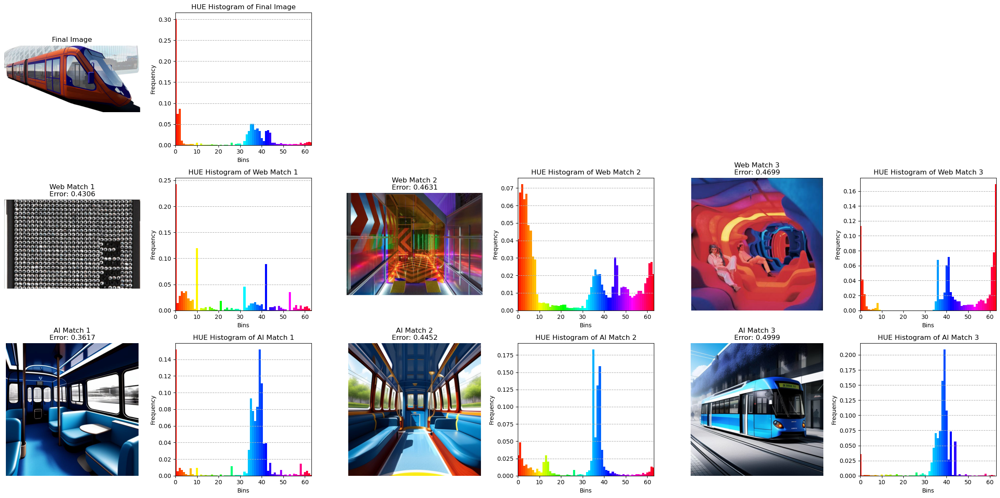

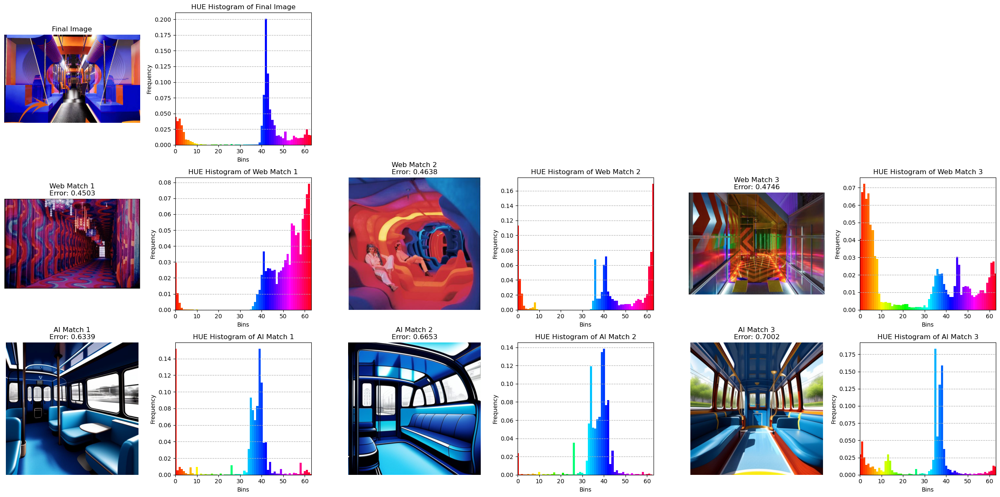

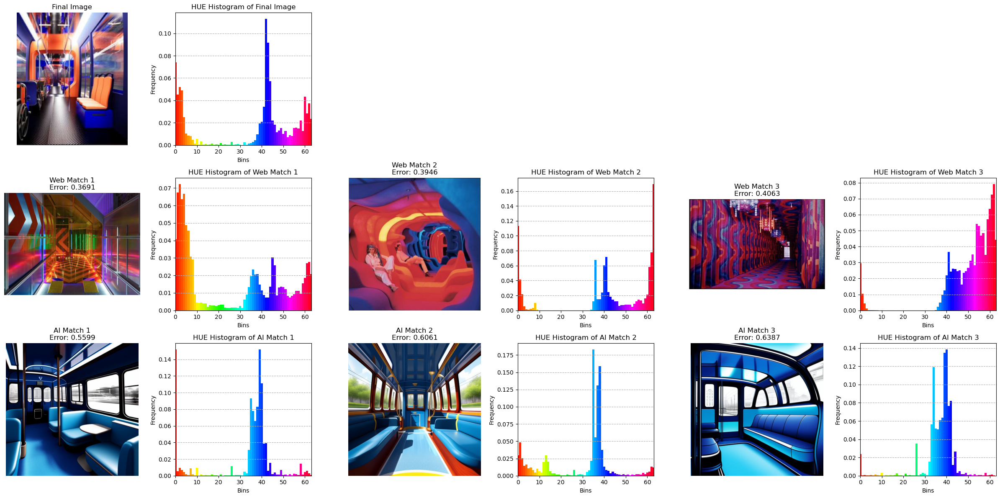

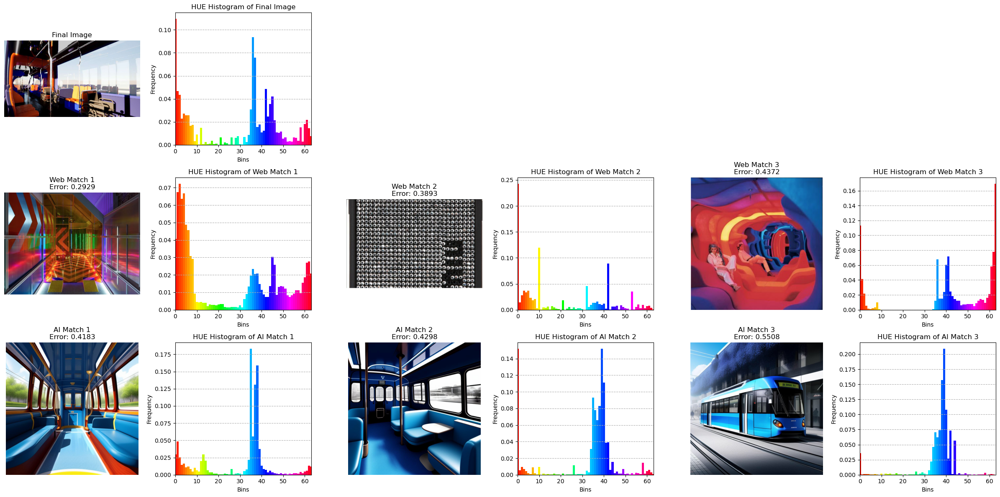

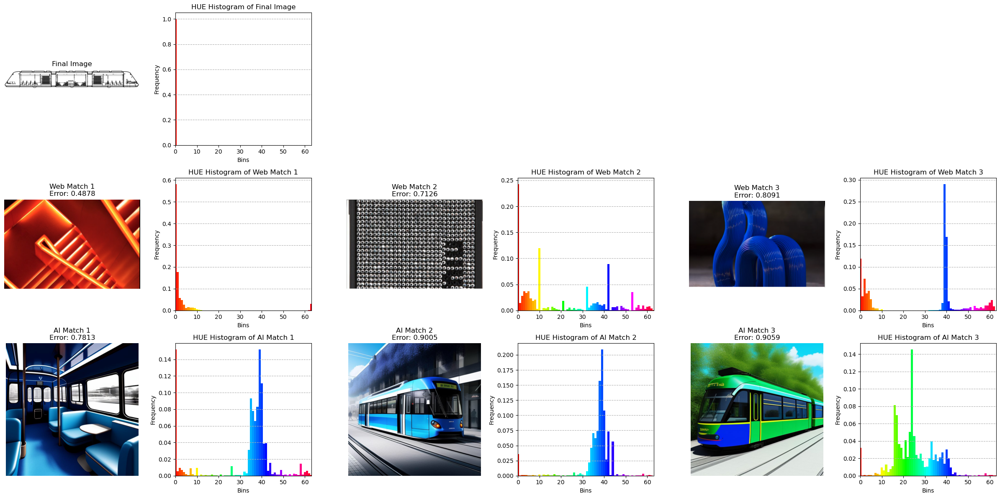

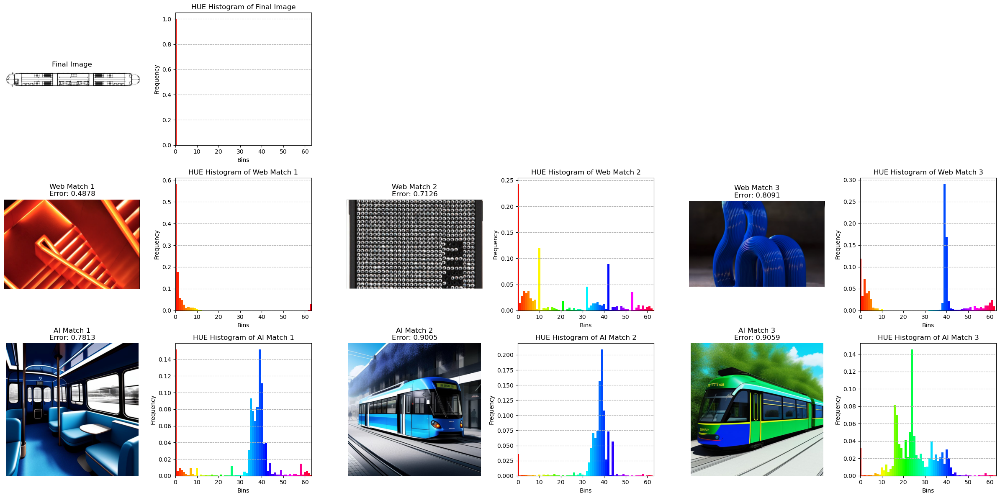

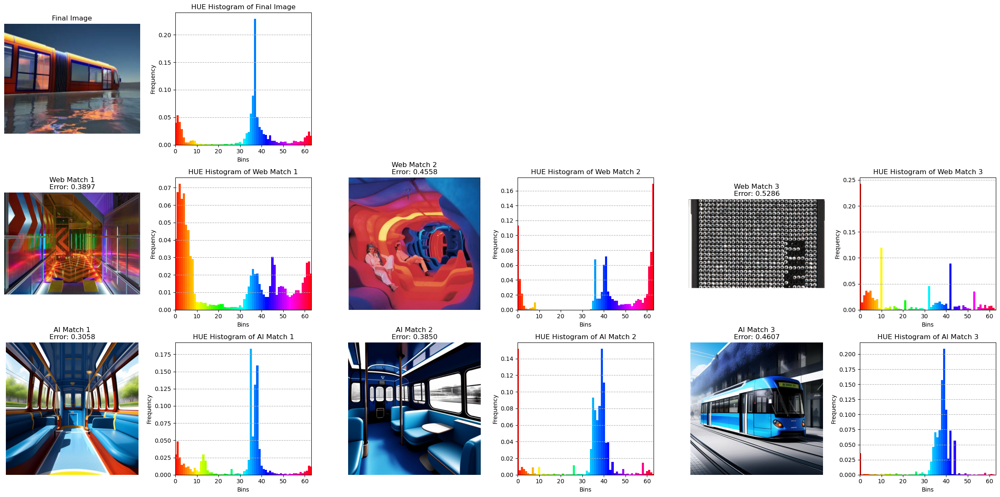

In [24]:
compare_colors(22, 64, 'hue')

### RGB top 3 matches

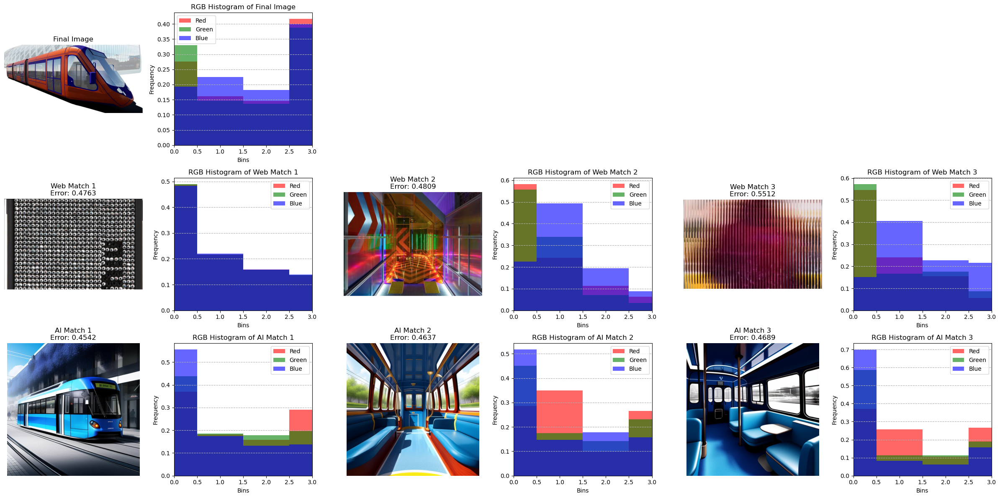

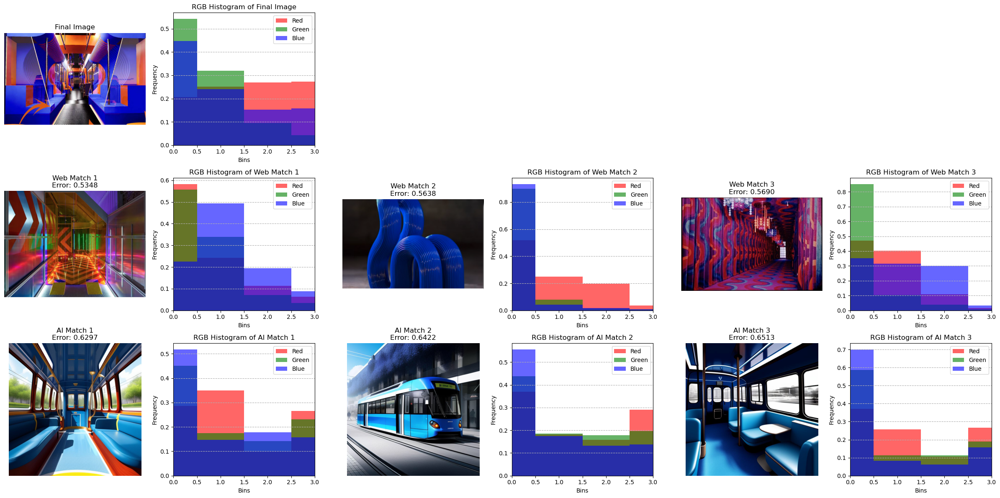

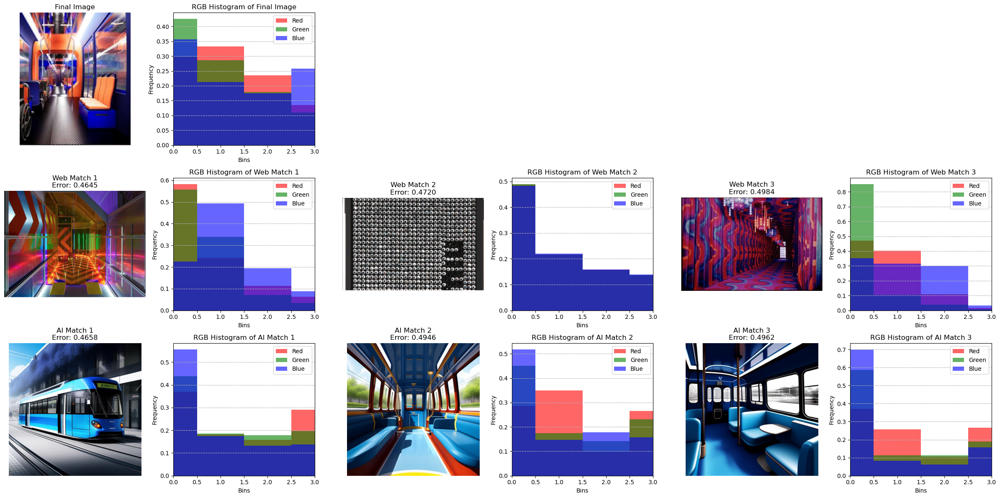

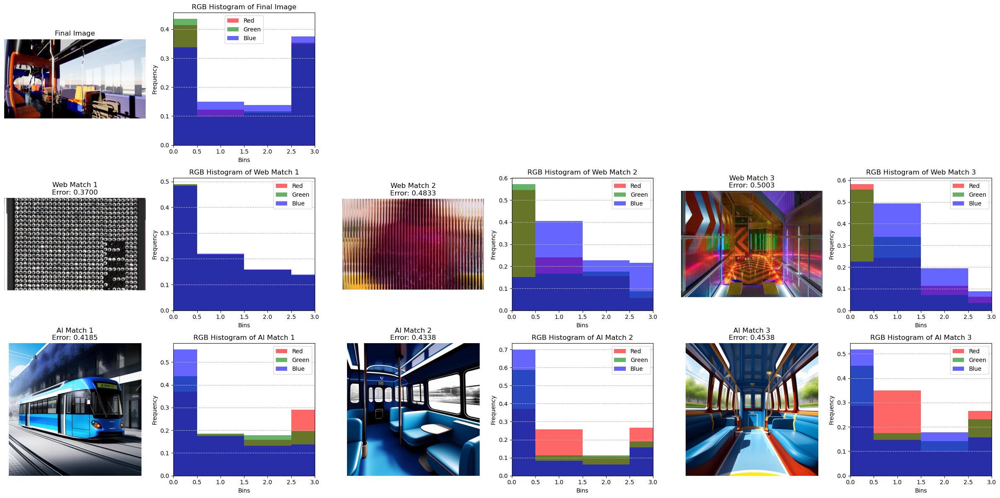

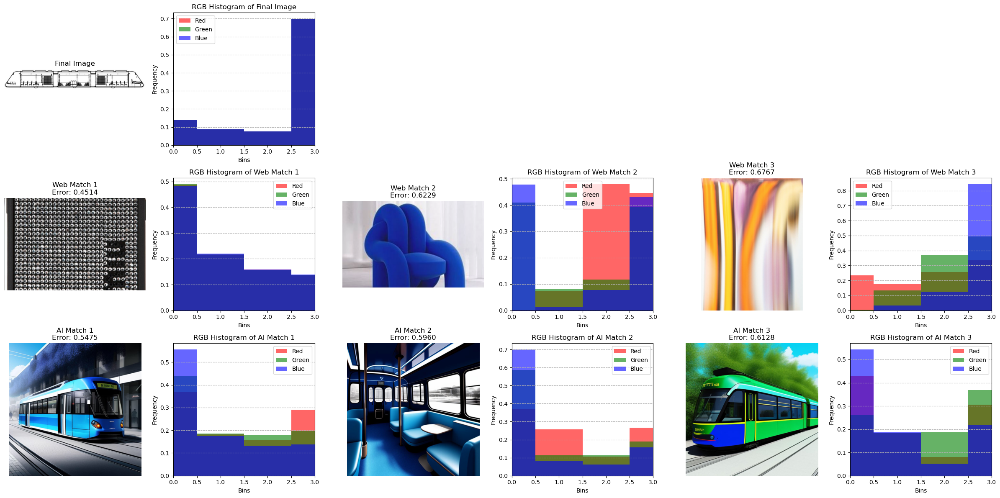

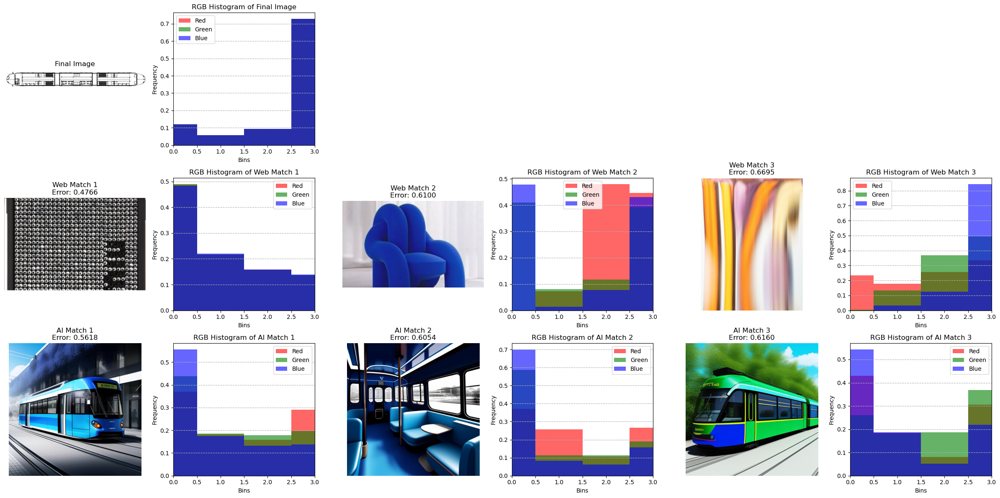

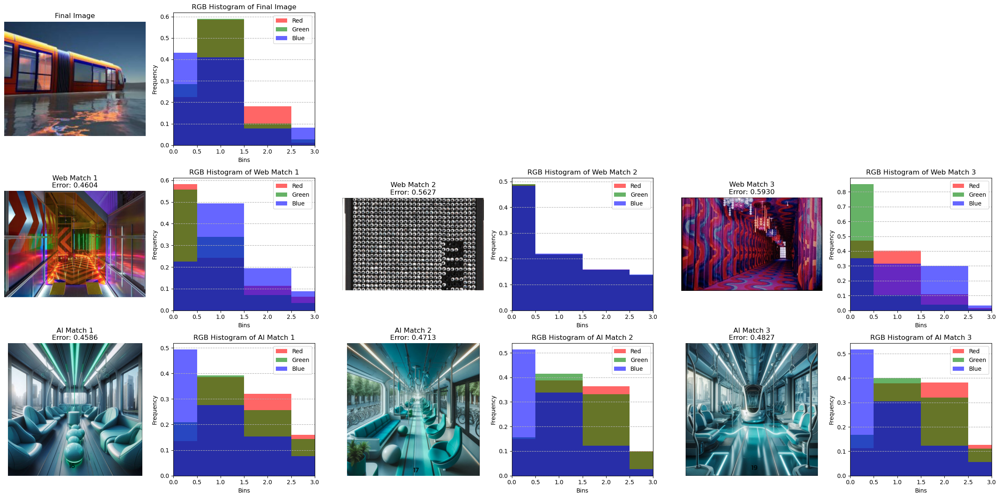

In [25]:
compare_colors(22, 4, 'rgb')